# Exploratory Data Analysis 

### Loading modules

We need to load the modules to our python environment using the command import

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as scp
%matplotlib inline
plt.rcParams['figure.figsize'] = 8,4
import warnings
warnings.filterwarnings('ignore')

from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
import plotly.graph_objs as go
import chart_studio.plotly as py
import plotly.express as px

### Loading the data

Because the dataset was downloaded as a `csv file`, we will use the **Pandas** command `read_csv` that automatically reads the file into a `DataFrame`.

In [2]:
import os
os.chdir('C:/Users/user/Documents/CFPB-Data-Analysis/raw_data/')
df = pd.read_csv('Consumer_Complaints.csv')

We can check the shape of our DataFrame to match the specifications provided for our dataset: 1048575 complaints(rows), 18 features(columns)

In [3]:
df.shape

(1048575, 18)

As we can see above, the dataset has 1048575 rows corresponding to the number of patients included in this study, and 18 columns, corresponding to the features or characteristics collected for each complaint.

### Exploratory Analysis

An important part of doing predictions with Machine Learning techniques is to perform Exploratory Data Analysis (EDA). This is useful for getting to know your data, looking at it from different perspectives, describing  and summarizing it without making any assumption in order to detect any potential problems.

First, we can inspect our data to see if we need to clean it. We will start by using the `head` command, that will show us the first 5 rows of our DataFrame.

In [4]:
df.head()

,Date received,Product,Sub-product,Issue,Sub-issue,Consumer complaint narrative,Company public response,Company,State,ZIP code,Tags,Consumer consent provided?,Submitted via,Date sent to company,Company response to consumer,Timely response?,Consumer disputed?,Complaint ID
0,12/1/2011,Credit card,NaN,Identity theft / Fraud / Embezzlement,NaN,NaN,NaN,CAPITAL ONE FINANCIAL CORPORATION,TX,75110,NaN,NaN,Referral,12/1/2011,Closed with relief,Yes,No,2272
1,12/1/2011,Credit card,NaN,APR or interest rate,NaN,NaN,NaN,CAPITAL ONE FINANCIAL CORPORATION,CA,945XX,NaN,NaN,Web,12/2/2011,Closed without relief,Yes,Yes,2215
2,12/1/2011,Credit card,NaN,Other,NaN,NaN,NaN,SYNCHRONY FINANCIAL,MN,55311,NaN,NaN,Referral,12/1/2011,Closed without relief,Yes,No,2283
3,12/1/2011,Mortgage,Other mortgage,"Loan modification,collection,foreclosure",NaN,NaN,NaN,"SUNTRUST BANKS, INC.",TN,374XX,NaN,NaN,Referral,12/1/2011,Closed without relief,Yes,No,2286
4,12/1/2011,Credit card,NaN,Billing disputes,NaN,NaN,NaN,BMO HARRIS BANK NATIONAL ASSOCIATION,PA,19014,NaN,NaN,Web,3/5/2012,Closed with relief,Yes,No,2393


As we can see above, there are missing values identified with the 'NaN' symbol. Additionally, there are a number of features that are not relevant to our investigation that we can drop.  Knowing the data types of the variable included in our dataset is a crucial piece of information.  We can check this by using `dtypes` function.

In [5]:
#Clean column headers up
df.columns = ['DateReceived', 'Product', 'SubProduct', 'Issue','SubIssue','ConsumerComplaintNarrative', 
               'CompanyPublicResponse', 'Company', 'State', 'ZIPCode', 'Tags', 'ConsumerConsentProvided?',
               'SubmittedVia', 'DateSentToCompany', 'CompanyResponseToConsumer', 'TimelyResponse', 
               'ConsumerDisputed', 'ComplaintID']

drop_columns = ['Tags',
                'CompanyPublicResponse',
                'ConsumerConsentProvided?',
                'DateSentToCompany',
                'ComplaintID']

df = df.drop(drop_columns, 1) 

df.dtypes

DateReceived                  object
Product                       object
SubProduct                    object
Issue                         object
SubIssue                      object
ConsumerComplaintNarrative    object
Company                       object
State                         object
ZIPCode                       object
SubmittedVia                  object
CompanyResponseToConsumer     object
TimelyResponse                object
ConsumerDisputed              object
dtype: object

As we can see above, 14 of our 14 variable appear to be `object` data type. Some of these variable are categoricals and some of them are numericals.

Because for machine learning algorithms, it is required to have numerical data, we will convert categorical data that has values 'no', 'yes' to 0 and 1 respectively. Another important point to consider the outcome of the complaint, was it closed with some sort of monetary relief, or without any monetary relief; and did the customer dispute the result or not.  We will use for this task, the function `replace`

In [6]:
replacements = {'No': 0,
               'Yes': 1,
               'Untimely response' : 0,
               'Closed without relief': 0,
               'Closed' : 0,
               'Closed with explanation': 1,
               'Closed with non-monetary relief' : 1,
               'In progress' : np.nan,
               'Closed with relief': 1,
               'Closed with monetary relief' : 1}

df.replace(replacements, inplace = True)

In [7]:
df.head()

,DateReceived,Product,SubProduct,Issue,SubIssue,ConsumerComplaintNarrative,Company,State,ZIPCode,SubmittedVia,CompanyResponseToConsumer,TimelyResponse,ConsumerDisputed
0,12/1/2011,Credit card,NaN,Identity theft / Fraud / Embezzlement,NaN,NaN,CAPITAL ONE FINANCIAL CORPORATION,TX,75110,Referral,1.0,1,0.0
1,12/1/2011,Credit card,NaN,APR or interest rate,NaN,NaN,CAPITAL ONE FINANCIAL CORPORATION,CA,945XX,Web,0.0,1,1.0
2,12/1/2011,Credit card,NaN,Other,NaN,NaN,SYNCHRONY FINANCIAL,MN,55311,Referral,0.0,1,0.0
3,12/1/2011,Mortgage,Other mortgage,"Loan modification,collection,foreclosure",NaN,NaN,"SUNTRUST BANKS, INC.",TN,374XX,Referral,0.0,1,0.0
4,12/1/2011,Credit card,NaN,Billing disputes,NaN,NaN,BMO HARRIS BANK NATIONAL ASSOCIATION,PA,19014,Web,1.0,1,0.0


Lastly, we will convert all of our binary columns in the dataset to **float** type.

In [8]:
binarylist = ['CompanyResponseToConsumer', 'TimelyResponse', 'ConsumerDisputed']
df[binarylist] = df[binarylist].astype(float)

df.dtypes

DateReceived                   object
Product                        object
SubProduct                     object
Issue                          object
SubIssue                       object
ConsumerComplaintNarrative     object
Company                        object
State                          object
ZIPCode                        object
SubmittedVia                   object
CompanyResponseToConsumer     float64
TimelyResponse                float64
ConsumerDisputed              float64
dtype: object

**Class Imbalance**  
Class imbalance occurs when the total number of observations in one class is significantly lower that the observations in the other class. Machine learning algorithms perform well when the number of observations in each class are similar but when there is a high class imbalance (90% in one class, 10% in the other class), problems arise leading to misclassification. 

In order to check whether our data set suffers from class imbalance, we can calculate what percentage of the data belongs to each category. 

In [9]:
total_of_complaints = df.shape[0]
total_of_closed_with_relief = (np.sum(df['CompanyResponseToConsumer'] == 1)/total_of_complaints)*100
total_of_closed_without_relief = (np.sum(df['CompanyResponseToConsumer'] == 0)/total_of_complaints)*100
print("Closed with relief:", round(total_of_closed_with_relief,2),"%")
print("Closed without relief:", round(total_of_closed_without_relief,2),"%")

Closed with relief: 96.5 %
Closed without relief: 3.1 %


We can observe that even though our dataset suffers from high class imbalance. There will be ways to address this later on in order to go forward with our analysis. 

We will use the function `apply` and `value_counts` to get the counts in every level for each discrete variable in our dataset.

In [10]:
categorical_variables = ['CompanyResponseToConsumer', 'TimelyResponse', 'ConsumerDisputed']
df[categorical_variables].apply(pd.Series.value_counts)

,CompanyResponseToConsumer,TimelyResponse,ConsumerDisputed
0.0,32558,26219,497132
1.0,1011902,1022356,117881


In this case, there is a marked predominance of observations belonging to level 1 in the variable CompanyResponseToConsumer and TimelyResponse which means that companies are generally responding to consumers quickly and with some sort of relief. Additionally, only part of our total dataset includes data collected on Consumer Disputes, the majority belong to level 0, indicating that most consumers did not file complaints.

The next step is to create some visuals in order to understand further our dataset by exploring relationships existent in it. For this, it is very useful to use the `textblob` library that we imported previously. Textblob will allow us to perform textual analysis.

In [11]:
dfCCN = df[~df['ConsumerComplaintNarrative'].isnull()]

In [12]:
cat_variables = ['ConsumerComplaintNarrative']
dfCCN[cat_variables].shape # 331,077 instances

(331077, 1)

In [13]:
dfCCN['polarity'] = dfCCN['ConsumerComplaintNarrative'].map(lambda text: TextBlob(text).sentiment.polarity)
dfCCN['review_len'] = dfCCN['ConsumerComplaintNarrative'].astype(str).apply(len)
dfCCN['word_count'] = dfCCN['ConsumerComplaintNarrative'].apply(lambda x: len(str(x).split()))

In [14]:
print('5 random reviews with the lowest negative sentiment polarity: \n')
cl = dfCCN.loc[dfCCN.polarity == -1, ['ConsumerComplaintNarrative']].sample(5).values
for c in cl:
    print(c[0])
    print('---')

5 random reviews with the lowest negative sentiment polarity: 

I ca n't bring up any of my account money or Rush Goals have my money. I 'm waiting on {$200.00} to be released. Rushcard has been horrible with fixing this information
---
Borrowed XXXX, owe XXXX while making payments. Will not set up payment plan or stop outrageous interest.
---
i had a loan with green tree and now they say i have to pay ditech for my manufacued home they are taking my rights away in mississippi i need help at XXXX XXXX XXXX in XXXX ms. please help me god!!!!!!!!!!!!
---
I have been on the phone and ca n't get through this horrible phone system and sit and wait for the fraud area to pick up for over an hour and then it just disconnects. I am out {$100.00} that I need to feed my kids with and I ca n't get any response. I have had it! I ca n't get anyone to provide the police report details to.
---
I sumbmited a complaint on 21 st mortgage THERE RESPONSE WAS THAT WE SINGED THE CONTRACT. THE CONTRACT SIGNED

In [15]:
print('5 random reviews with the most neutral sentiment polarity: \n')
cl = dfCCN.loc[dfCCN.polarity == 0, ['ConsumerComplaintNarrative']].sample(5).values
for c in cl:
    print(c[0])
    print('---')

5 random reviews with the most neutral sentiment polarity: 

There is information reporting on my credit file that does not belong me. There is a medical account XXXX XXXX - XXXX XXXX and also there are unauthorized inquiries and incorrect personal information that is reporting. Please assist me in getting these items removed from my credit report. 

There are unauthorized inquiries reporting on my credit file : XXXX XXXX XXXX XXXX XXXX XXXX XXXX XXXX ( 2 times ) XXXX XXXX XXXX XXXX XXXX XXXX XXXX ( 3 times ) XXXX XXXX XXXX ( 2 times ) XXXX XXXX XXXX Incorrect Personal Information : Address : XXXX and XXXX Names : XXXX
---
I have disputed a collection on my report from XXXX XXXX XXXX XXXX who claims they are collecting on behalf of XXXX. Account number that shows is XXXX. Transunion refuses to remove this incorrect collection from my report. I am including proof I do not owe money for this. As you can see I have a {$0.00} balance with XXXX because student loans paid for this.
---
Conse

In [16]:
print('5 random reviews with the highest positive sentiment polarity: \n')
cl = dfCCN.loc[dfCCN.polarity == 1, ['ConsumerComplaintNarrative']].sample(5).values
for c in cl:
    print(c[0])
    print('---')

5 random reviews with the highest positive sentiment polarity: 

I am not understanding why the word our is capitalized on the dispute results. I chose the best categories for the dispute.
---
I have sent in a couple dispute letters for some collections that are not mine. I have never been to these place the hospitals on the collection companies books. Nothing has been done and when I call the collection companies they threaten to sue me! why ... I never had treatment and if I did my insurance would have covered it and a co-pay I also have money for that. I 'm hoping the credit bureau will do their best to help me bc i 've already tried disputing and nothing has happened. I uploaded the documents requested thx
---
I went in for consultation before you can even go in side to see the DR you must pay ya co payment and the insurance pay the rest XXXX ... I have excellent credit they sent {$40.00} to collection that I do not owe at all. Collection agency _ C/O MEDRECOVERY SOLUTIONS LLC XXXX

The sentiment analysis by and large functions as intended, the limitations are evident when looking at the most positive complaints -- such as consumers mentioning they have "excellent credit" but were hit with issues.  We will have to bear in mind for our analysis that the entire dataset is complaints, so the sentiment polarity represents a spectrum of intensity.

In [17]:
fig = px.histogram(dfCCN, x="polarity", nbins=30,
                   title='Sentiment Polarity Distribution',
                   labels={'polarity':'polarity'}, # can specify one label per df column
                   opacity=0.8,
                   log_y=True, # represent bars with log scale
                   color_discrete_sequence=['indianred'] # color of histogram bars
                   )
fig.show()

The polarity is largely normally distributed with some extremes at the edges.  The extremes are expected given the intensity of some of the complaints.

In [18]:
fig = px.histogram(dfCCN, x="review_len", nbins=350,
                   title='Complaint Length Distribution',
                   labels={'review_len':'Complaint Length'}, # can specify one label per df column
                   opacity=0.8,
                   log_y=True, # represent bars with log scale
                   color_discrete_sequence=['indianred'] # color of histogram bars
                   )
fig.show()

Most complaints are a little over 100 characters in length with a number of outliers.

In [20]:
fig = px.histogram(dfCCN, x="word_count", nbins=150,
                   title='Complaint Word Count Distribution',
                   labels={'word_count':'Complaint Word Count'}, # can specify one label per df column
                   opacity=0.8,
                   log_y=True, # represent bars with log scale
                   color_discrete_sequence=['indianred'] # color of histogram bars
                   )
fig.show()

The complaint word count is similar to the complaint length, as expected.

For categorical features, we will use a bar chart to present the frequency.  First we will need to clean the Product feature to group together similar entries.

In [21]:
dfCCN['Product'].replace(
    to_replace=['Credit reporting, credit repair services, or other personal consumer reports'],
    value='Credit reporting',
    inplace=True
)

dfCCN['Product'].replace(
    to_replace=['Credit card'],
    value='Credit card or prepaid card',
    inplace=True
)

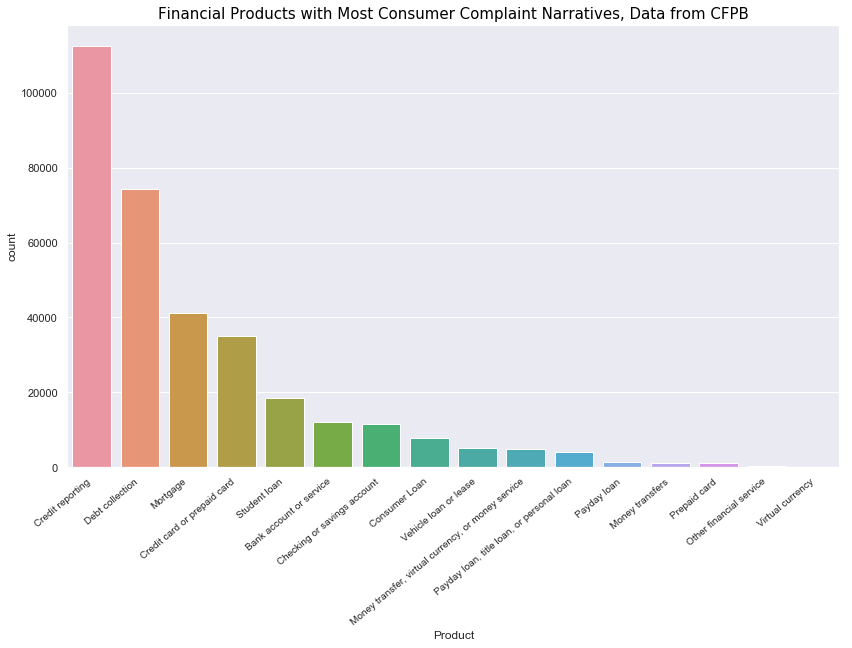

In [22]:
sns.set(rc={'figure.figsize':(12,9)})
prods = sns.countplot(x='Product', data=dfCCN, 
                  order=dfCCN.Product.value_counts().iloc[:16].index)
prods.set_xticklabels(prods.get_xticklabels(), rotation=40, ha="right", fontsize=10)
plt.tight_layout()
plt.title("Financial Products with Most Consumer Complaint Narratives, Data from CFPB", fontsize=15,
         color='Black', fontname='Console')
plt.show()

Credit reporting gets the most number of consumer complaint narratives, followed by debt collection, and then mortgage.  Interestingly, for the entire data set in the original dataframe, the ranking of the amount of complaints had credit reporting ranked first, second being mortgage, and third being debt collection.  It seems consumers feel the need to write narratives and explanations more for debt collection and credit reporting, rather than other issues.

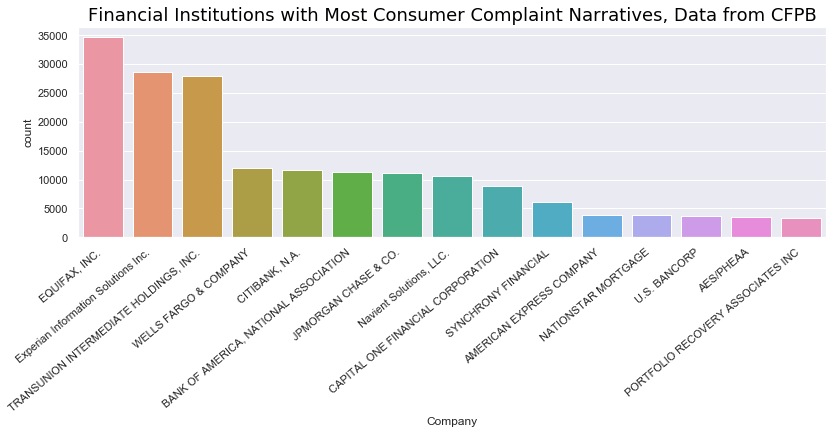

In [23]:
sns.set(rc={'figure.figsize':(12,6)})
ax = sns.countplot(x='Company', data=dfCCN, 
                  order=dfCCN.Company.value_counts().iloc[:15].index)
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
plt.tight_layout()
plt.title("Financial Institutions with Most Consumer Complaint Narratives, Data from CFPB", fontsize=18,
         color='Black', fontname='Console')
plt.show()

As expected based on our previous graph, the major credit reporting agencies have the most complaint narratives, followed by the major banks.  Notably, Wells Fargo is the top financial institution  after the credit agencies -- this is in line with the reputational damage that has occurred with Wells Fargo in recent years.

In [24]:
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer().fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_words(dfCCN['ConsumerComplaintNarrative'], 20)
df1 = pd.DataFrame(common_words, columns = ['unigrams' , 'count'])

In [25]:
fig = px.bar(df1, x='unigrams', y='count', title='Top Unigrams Prior to Removing Stop Words')
fig.show()

In [26]:
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer(stop_words = 'english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_words(dfCCN['ConsumerComplaintNarrative'], 20)
df2 = pd.DataFrame(common_words, columns = ['unigrams' , 'count'])

In [27]:
df2c = df2[2:]

In [28]:
df2c.head()

,unigrams,count
2,credit,514580
3,account,427371
4,00,304387
5,report,220557
6,payment,215168


In [29]:
fig = px.bar(df2c, x='unigrams', y='count', title='Top Unigrams After Removing Stop Words')
fig.show()

Credit is again the leader in issues among consumers, followed by account, and then payment (+ payments).

In [30]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_bigram(dfCCN['ConsumerComplaintNarrative'], 20)
df3 = pd.DataFrame(common_words, columns = ['bigrams' , 'count'])

In [31]:
fig = px.bar(df3, x='bigrams', y='count', title='Top Bigrams Prior to Removing Stop Words')
fig.show()

In [32]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_bigram(dfCCN['ConsumerComplaintNarrative'], 20)
df4 = pd.DataFrame(common_words, columns = ['bigrams' , 'count'])

In [33]:
df4c = df4[~df4.bigrams.str.contains("xxxx")]

In [34]:
df4c1 = df4c[~df4c.bigrams.str.contains("xx")]

In [35]:
fig = px.bar(df4c1, x='bigrams', y='count', title='Top Bigrams After Removing Stop Words')
fig.show()

The top issues are clearly around credit (5 out of 9), notably two of the top nine are also companies "wells fargo" and "bank [of] america."

In [36]:
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_trigram(dfCCN['ConsumerComplaintNarrative'], 20)
df5 = pd.DataFrame(common_words, columns = ['trigrams' , 'count'])

In [37]:
fig = px.bar(df5, x='trigrams', y='count', title='Top Trigrams Prior to Removing Stop Words')
fig.show()

In [38]:
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_trigram(dfCCN['ConsumerComplaintNarrative'], 50)
df6 = pd.DataFrame(common_words, columns = ['trigrams' , 'count'])

In [39]:
df6c = df6[~df6.trigrams.str.contains("xxxx")]

In [40]:
df6c1 = df6c[~df6c.trigrams.str.contains("xx")]

In [41]:
fig = px.bar(df6c1, x='trigrams', y='count', title='Top Trigrams After Removing Stop Words')
fig.show()

Evidently, the majority of trigrams are around credit reporting.

```
y0 = dfCCN.loc[dfCCN['Product'] == 'Credit reporting']['polarity']
y1 = dfCCN.loc[dfCCN['Product'] == 'Debt collection']['polarity']
y2 = dfCCN.loc[dfCCN['Product'] == 'Mortgage']['polarity']
y3 = dfCCN.loc[dfCCN['Product'] == 'Credit card or prepaid card']['polarity']
y4 = dfCCN.loc[dfCCN['Product'] == 'Student loan']['polarity']
y5 = dfCCN.loc[dfCCN['Product'] == 'Bank account or service']['polarity']

trace0 = go.Box(
    y=y0,
    name = 'Credit reporting',
    marker = dict(
        color = 'rgb(214, 12, 140)',
    )
)
trace1 = go.Box(
    y=y1,
    name = 'Debt collection',
    marker = dict(
        color = 'rgb(0, 128, 128)',
    )
)
trace2 = go.Box(
    y=y2,
    name = 'Mortgage',
    marker = dict(
        color = 'rgb(10, 140, 208)',
    )
)
trace3 = go.Box(
    y=y3,
    name = 'Credit card or prepaid card',
    marker = dict(
        color = 'rgb(12, 102, 14)',
    )
)
trace4 = go.Box(
    y=y4,
    name = 'Student loan',
    marker = dict(
        color = 'rgb(10, 0, 100)',
    )
)
trace5 = go.Box(
    y=y5,
    name = 'Bank account or service',
    marker = dict(
        color = 'rgb(100, 0, 10)',
    )
)
data = [trace0, trace1, trace2, trace3, trace4, trace5]
layout = go.Layout(
    title = "Sentiment Polarity Boxplot of Major Products"
)

fig = go.Figure(data=data,layout=layout)

fig.show()```

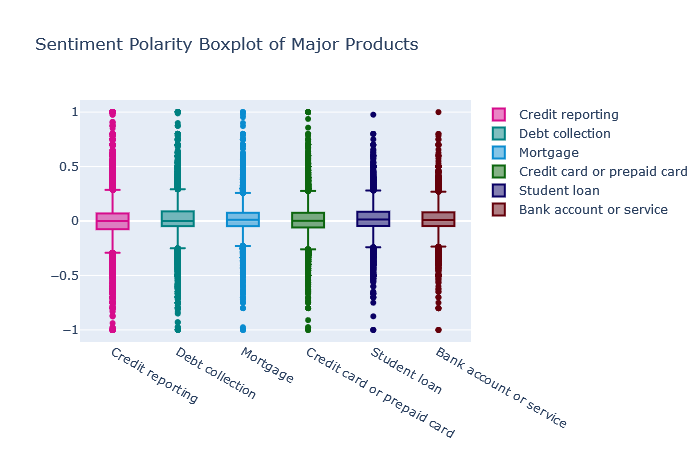

There are no major variations in sentiment among the different products.

In [43]:
x1 = dfCCN.loc[df['ConsumerDisputed'] == 1, 'polarity']
x0 = dfCCN.loc[df['ConsumerDisputed'] == 0, 'polarity']

trace1 = go.Histogram(
    x=x0, name='Not Disputed',
    opacity=0.75
)
trace2 = go.Histogram(
    x=x1, name = 'Disputed',
    opacity=0.75
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay', title='Distribution of Sentiment Polarity of Complaints based on Disputes')
fig = go.Figure(data=data, layout=layout)

fig.show()

There are no major differences in polarity among disputed and non-disputed complaints.

In [44]:
x1 = dfCCN.loc[dfCCN['ConsumerDisputed'] == 1, 'review_len']
x0 = dfCCN.loc[dfCCN['ConsumerDisputed'] == 0, 'review_len']

trace1 = go.Histogram(
    x=x0, name='Not Disputed',
    opacity=0.50
)
trace2 = go.Histogram(
    x=x1, name = 'Disputed',
    opacity=0.60
)

data = [trace1, trace2]
layout = go.Layout(barmode='overlay', title='Distribution of Complaint Length based on Disputes')
fig = go.Figure(data=data, layout=layout)

fig.show()

Past the 3000 complaint length mark, we can see that the likelihood of a dispute happening increases.

---------

This concludes our exploratory data analysis of the financial market.